# AuxTel validation with simulated batoid data


Owner: **Chris Suberlak** ([@suberlak](https://github.com/lsst-ts/ts_analysis_notebooks/issues/new?body=@suberlak))
<br>Last Verified to Run: **2022-04-12**
<br>Software Versions:
  - `ts_wep`: **v2.3.4**
  - `lsst_distrib`: **w_2022_15**
  
## Goal

Use simulated batoid data (courtesy of J. Meyers). These are numpy arrays, hence use actual AT FITS image headers for the metadata ansatz. The metadata is not used directly in the analysis, since we use `GenerateDonutDirectDetect` task to detect donuts with template fitting, which ignores the WCS data. We input FOCUSZ values so that one image is intra, and the other extra-focal (this is the only usage of FOCUSZ in the AOS pipeline for AT). The AT test data are exposures 2021032300308, 2021032300309, as used in https://github.com/lsst-ts/ts_externalscripts/blob/develop/tests/auxtel/test_latiss_cwfs_align.py#L222 and 
https://github.com/lsst-ts/ts_externalscripts/blob/develop/tests/auxtel/test_latiss_cwfs_align.py#L412
    



## Setup:
    
   * access to NCSA lsst-devl nodes 
   * working installation of ts_wep package ( see the following [notes](https://confluence.lsstcorp.org/display/LTS/Onboarding+to+LSST+AOS) for additional info on how to install and build the AOS packages)
    
It is assumed that `ts_analysis_notebooks` resides in `$PATH_TO_TS_ANALYSIS_NOTEBOOKS`. Here it was `/project/scichris/aos/ts_analysis_notebooks`.

At least once after cloning the `ts_analysis_notebooks` repo one needs to run the `setup` and `scons` commands. It can be  for example:
   
    cd $PATH_TO_TS_ANALYSIS_NOTEBOOKS
    setup -k -r .
    scons 

Setup (that was used to run the analysis on a notebook opened in a browser using an ssh connection to the NCSA machine). `$USER` stands for NCSA  username, and `/project/scichris/aos/setup_aos_current.sh` is the setup script that loads the AOS packages. In particular, the `ts_wep` installation used was `/project/scichris/aos/ts_wep` . The `54467` can be any other port number, as long as it is consistent between `ssh` connection and the jupyter notebook. The content of the setup script is 




    #!/usr/bin/env bash

    # NOTE: this is to be used in conjunction with 
    # a call to lsst stack 

    # on LSST-DEVL, this would be 
    # >>  source "/opt/lsst/software/stack/loadLSST.bash"

    # on LSP (from the jupyterlab terminal)
    # it would be 
    # >>  source ${LOADSTACK}
    # which does : 
    # >>  source "/opt/lsst/software/stack/loadLSST.bash" 

    export PATH_TO_TS_WEP=/project/scichris/aos/ts_wep/
    export PATH_TO_TS_OFC=/project/scichris/aos/ts_ofc/
    export PATH_TO_TS_PHOSIM=/project/scichris/aos/ts_phosim/
    export PATH_TO_PHOSIM_UTILS=/project/scichris/aos/phosim_utils/

    setup phosim_utils -t $USER  -t current
setup ts_phosim -t  $USER -t current
    setup lsst_distrib -t current

    export PHOSIMPATH=/project/scichris/aos/phosim_syseng4/
    export LSST_ALLOW_IMPLICIT_THREADS=True
    export AOCLCOUTPUTPATH=/project/scichris/aos/aoclc_output/

If other installations of `ts_wep` or `ts_phosim` or other AOS packages are to be employed, the paths need to be updated accordingly. 

Run in the terminal on the local machine:

    ssh -L 54467:localhost:54467 $USER@lsst-devl02
    
Run in the NCSA terminal after DUO authentication (I aliased these in `~/.bash_profile`:

    source "/software/lsstsw/stack/loadLSST.bash"
    setup lsst_distrib     # first two aliased with "lsst"
    
    source /project/scichris/aos/setup_aos_current.sh  # aliased as "aos"
    
    setup -k -r $PATH_TO_TS_ANALYSIS_NOTEBOOKS
    
    jupyter notebook --no-browser --port=54467         # aliased as "jup" 
   
This should open the browser at the NCSA `/jhome` directory.  I navigate to `$PATH_TO_TS_ANALYSIS_NOTEBOOKS` to open this notebook.

// Based on https://github.com/suberlak/AOS/blob/main/AOS_AuxTel_simulation_data.ipynb  // 

## Show the simulated data 

In [5]:
!ls /home/jemeyers/AuxTelSims/M2-rigid/


Explore.ipynb	extra_007.fits	intra_005.fits	sim_003.yaml
extra_000.fits	extra_008.fits	intra_006.fits	sim_004.yaml
extra_001.fits	extra_009.fits	intra_007.fits	sim_005.yaml
extra_002.fits	intra_000.fits	intra_008.fits	sim_006.yaml
extra_003.fits	intra_001.fits	intra_009.fits	sim_007.yaml
extra_004.fits	intra_002.fits	sim_000.yaml	sim_008.yaml
extra_005.fits	intra_003.fits	sim_001.yaml	sim_009.yaml
extra_006.fits	intra_004.fits	sim_002.yaml	sim_at_m2_rigid.py


The `sim_xxx.yaml` files have input settings and true Zernike coefficients (for wavelength of 620 nm).

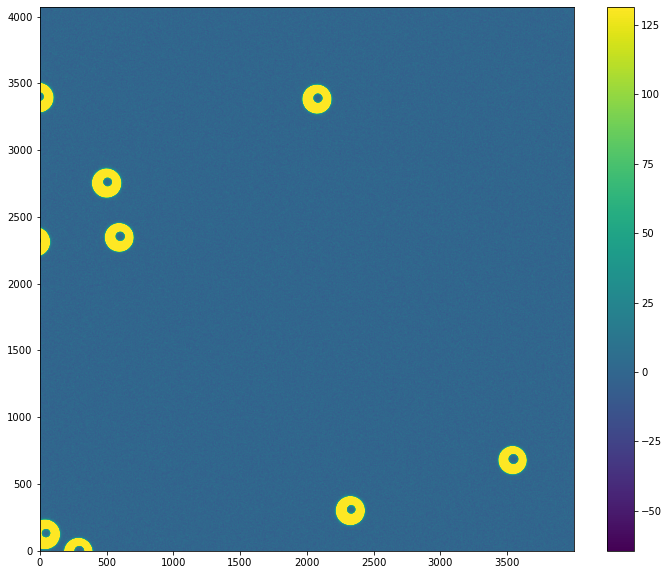

In [32]:
%matplotlib inline
from astropy.io import fits
from astropy.visualization import ZScaleInterval
import matplotlib.pyplot as plt
hdula = fits.open('/home/jemeyers/AuxTelSims/M2-rigid/extra_000.fits')
fig = plt.figure(figsize=(12, 10))
zscale = ZScaleInterval()
data = hdula[0].data
vmin, vmax = zscale.get_limits(data)
plt.imshow(data, origin='lower',vmin=vmin,vmax=vmax)
plt.colorbar()

I need to run ISR, because raw images have a different dimension than the postISR..


Show the dimension of raw data 



In [33]:
from lsst.daf import butler as dafButler
butler = dafButler.Butler('/repo/main/', instrument='LATISS')



exposure_extra = butler.get('raw', dataId={'instrument':'LATISS', 'detector':0, 
                                     'exposure':2021032300307},
                      collections=['LATISS/raw/all'])

exposure_intra = butler.get('raw', dataId={'instrument':'LATISS', 'detector':0, 
                                     'exposure':2021032300308},
                      collections=['LATISS/raw/all'])


/lsstdata/offline/instrument/LATISS/storage/2021-03-23/AT_O_20210323_000307-R00S00.fits: outAmp.getRawBBox() != data.getBBox(); patching. ((minimum=(0, 0), maximum=(543, 2047)) v. (minimum=(0, 0), maximum=(575, 2047)))
/lsstdata/offline/instrument/LATISS/storage/2021-03-23/AT_O_20210323_000308-R00S00.fits: outAmp.getRawBBox() != data.getBBox(); patching. ((minimum=(0, 0), maximum=(543, 2047)) v. (minimum=(0, 0), maximum=(575, 2047)))


In [29]:
print(exposure_extra.getMetadata()['FOCUSZ'])

-0.847813427448273


In [30]:
print(exposure_intra.getMetadata()['FOCUSZ'])

0.752186596393585


The more negative is extra-focal. We ensure that appropriately extra-focal simulation gets assigned to extra-focal exposure.

In [34]:
np.shape(exposure_intra.image.array)

(4096, 4608)

    ssh lsst-devl02

    source "/software/lsstsw/stack/loadLSST.bash"
    setup lsst_distrib

    pipetask run  --data-query "exposure IN (2021032300307,2021032300308,2021032300309,2021032300310,2021032300311) AND instrument='LATISS' " -b /repo/main/butler.yaml --input  LATISS/raw/all,LATISS/calib,u/czw/DM-28920/calib.20210720  --output u/$USER/Latiss/postISRtest --pipeline /project/scichris/aos/testLatiss4.yaml  --register-dataset-types

Show the dimension of the postISR data:

In [35]:
from lsst.daf import butler as dafButler
instrument = 'LATISS'
dataId0 = dict(instrument=instrument)
repo_dir = '/repo/main/'
butler = dafButler.Butler(repo_dir, collections=['run1'])
                          
dataset = next(iter(
                butler.registry.queryDatasets(
                    datasetType='postISRCCD', 
                    collections=['u/scichris/Latiss/postISRtest'],
                    dataId=dataId0  )
                )
           )

expN = dataset.dataId["exposure"]

# Get the refs  for this dataset
refs = []
for ref in butler.registry.queryDatasets(
                    datasetType='postISRCCD', 
                    collections=['u/scichris/Latiss/postISRtest'],
                    dataId=dataId0  ):
    refs.append(ref)

In [25]:
refs[0].dataId

{instrument: 'LATISS', detector: 0, exposure: 2021032300307, ...}

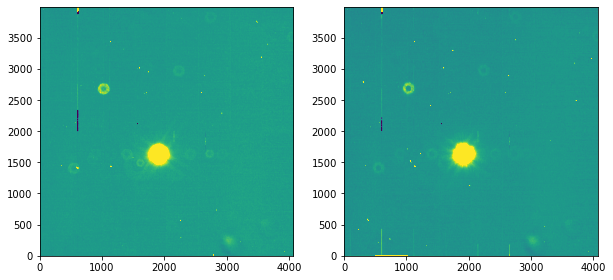

In [36]:
%matplotlib inline
from astropy.io import fits
from astropy.visualization import ZScaleInterval
import matplotlib.pyplot as plt
zscale = ZScaleInterval()
exp_extra = butler.get(datasetRefOrType='postISRCCD',dataId=refs[0].dataId,
              collections=['u/scichris/Latiss/postISRtest'])

exp_intra = butler.get(datasetRefOrType='postISRCCD',dataId=refs[1].dataId,
              collections=['u/scichris/Latiss/postISRtest'])

%matplotlib inline
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,2,figsize=(10,5))
data  = exp_intra.image.array
vmin, vmax = zscale.get_limits(data)
ax[0].imshow(data, origin='lower', vmin=vmin,vmax=vmax)

data  = exp_extra.image.array
vmin, vmax = zscale.get_limits(data)
ax[1].imshow(data, origin='lower', vmin=vmin,vmax=vmax)

In [37]:
np.shape(data)

(4000, 4072)

So indeed the dimension is different. Hence use these postISR exposures as the template.

Replace the numerical portion of the image with the simulated data:

In [48]:
import numpy as np
iNum=1
source ='Z4-Z22'
hdul2 = fits.open(f'/home/jemeyers/AuxTelSims/{source}/intra_00{iNum}.fits')
exp_intra.image.array[:] = np.transpose(hdul2[0].data)

hdul1 = fits.open(f'/home/jemeyers/AuxTelSims/{source}/extra_00{iNum}.fits')
exp_extra.image.array[:] = np.transpose(hdul1[0].data)

Plot the same exposures with replaced numerical portion:

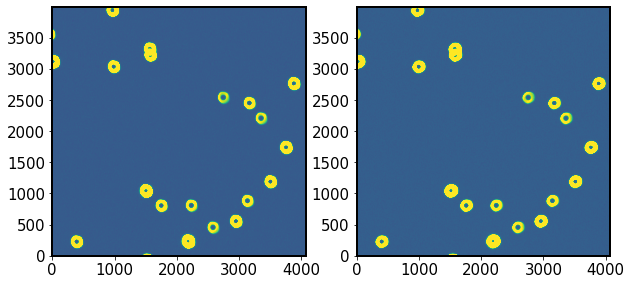

In [49]:
%matplotlib inline
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,2,figsize=(10,5))
data  = exp_extra.image.array
vmin, vmax = zscale.get_limits(data)
ax[0].imshow(data, origin='lower', vmin=vmin,vmax=vmax)

data  = exp_intra.image.array
vmin, vmax = zscale.get_limits(data)
ax[1].imshow(data, origin='lower', vmin=vmin,vmax=vmax)

First find donuts, then do the Zernike estimation on this exposure pair

In [50]:
from lsst.ts.wep.task.EstimateZernikesLatissTask import (EstimateZernikesLatissTask, 
EstimateZernikesLatissTaskConfig)
from lsst.ts.wep.task.GenerateDonutDirectDetectTask import (
GenerateDonutDirectDetectTask, GenerateDonutDirectDetectTaskConfig
)

donutDetectConfig = GenerateDonutDirectDetectTaskConfig(donutTemplateSize = 200,
                                            instName = 'auxTel',
                                            opticalModel = 'onAxis',
                                            peakThreshold = 0.99,
                                            binaryChoice = 'deblend') # adaptative image thresholding
donutDetectTask = GenerateDonutDirectDetectTask(config=donutDetectConfig)


estimateZernikeConfig = EstimateZernikesLatissTaskConfig(donutStampSize=200, 
                                                         donutTemplateSize=200,
                                                         opticalModel='onAxis')
estimateZernikeTask = EstimateZernikesLatissTask(config=estimateZernikeConfig)


donutCatalog = donutDetectTask.run(exp_intra)
donutCat = donutCatalog.donutCatalog

# declare the exposure pair
exposure_pair = [exp_intra, exp_extra ]



plot the detected donuts

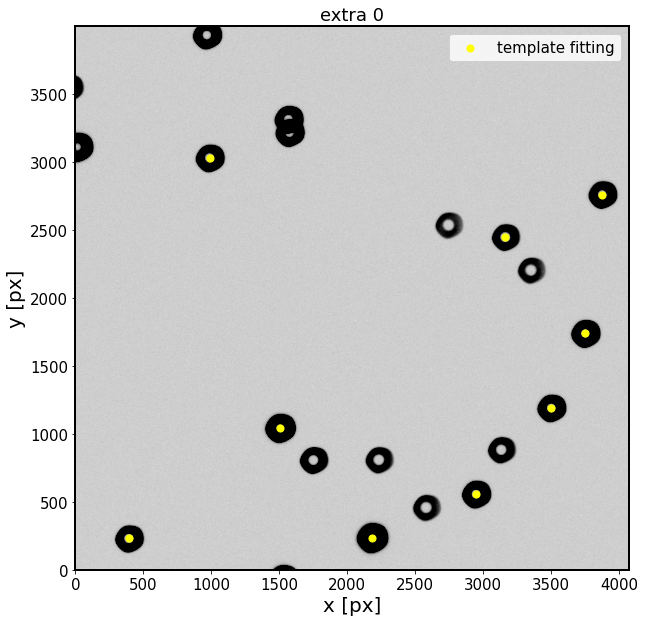

In [53]:
%matplotlib inline
from astropy.visualization import ZScaleInterval
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay
import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

import numpy as np 
import os 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18

data = exp_intra.image.array
zscale = ZScaleInterval()
vmin, vmax = zscale.get_limits(data)

fig,ax = plt.subplots(1,1,figsize=(10,10))
ax.imshow(data, vmin=vmin, vmax=vmax,cmap='Greys', origin='lower')
ax.scatter(donutCat['centroid_x'], donutCat['centroid_y'], s=50, c='yellow', label='template fitting')


ax.set_title('extra 0')
ax.set_xlabel('x [px]')
ax.set_ylabel('y [px]')
plt.legend()


In [54]:
camera = butler.get("camera",dataId={"instrument": "LATISS"}, 
                        collections=['u/scichris/Latiss/postISRtest'],)
zernikeOutput = estimateZernikeTask.run(exposure_pair, [donutCat], camera)


In [58]:
donutStamps = zernikeOutput.donutStampsExtra[0]

In [62]:
xy  = donutStamps[0].centroid_position

Point2D(2184, 236)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


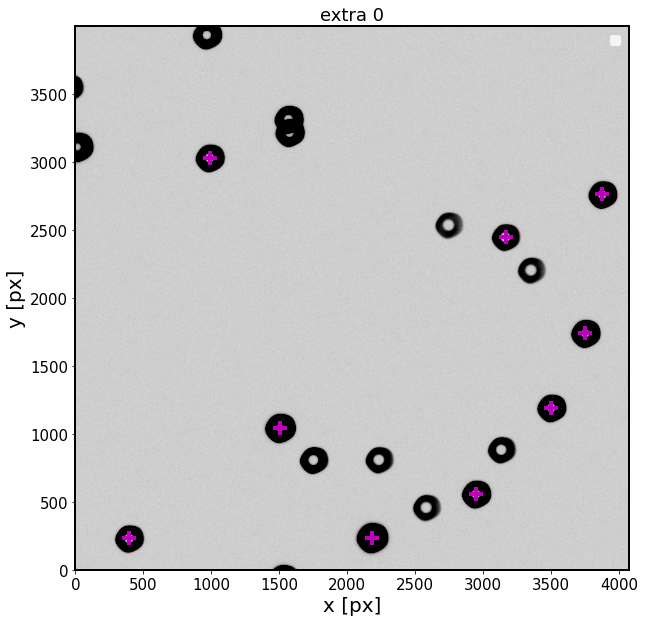

In [64]:
data = exp_intra.image.array
zscale = ZScaleInterval()
vmin, vmax = zscale.get_limits(data)

fig,ax = plt.subplots(1,1,figsize=(10,10))
ax.imshow(data, vmin=vmin, vmax=vmax,cmap='Greys', origin='lower')
#ax.scatter(donutCat['centroid_x'], donutCat['centroid_y'], s=50, c='yellow', label='template fitting')
for i in range(len(donutStamps)):
    xy  = donutStamps[i].centroid_position
    ax.scatter(xy[0], xy[1], s=200, marker='+' ,c='m', lw=4)

ax.set_title('extra 0')
ax.set_xlabel('x [px]')
ax.set_ylabel('y [px]')
#plt.legend()


In [ ]:
So the donuts stored in the zernikeOutputs structure are the same that I expected. Now need to figure out whether 

## Develop the loop for simulated data

In [13]:
from lsst.ts.wep.task.EstimateZernikesLatissTask import (EstimateZernikesLatissTask, 
EstimateZernikesLatissTaskConfig)
from lsst.ts.wep.task.GenerateDonutDirectDetectTask import (
GenerateDonutDirectDetectTask, GenerateDonutDirectDetectTaskConfig
)

# import all tasks and modules beforehand
donutDetectConfig = GenerateDonutDirectDetectTaskConfig(donutTemplateSize = 200,
                                            instName = 'auxTel',
                                            opticalModel = 'onAxis',
                                            peakThreshold = 0.99,
                                            binaryChoice = 'deblend') # adaptative image thresholding
donutDetectTask = GenerateDonutDirectDetectTask(config=donutDetectConfig)


estimateZernikeConfig = EstimateZernikesLatissTaskConfig(donutStampSize=200, 
                                                         donutTemplateSize=200,
                                                         opticalModel='onAxis')
estimateZernikeTask = EstimateZernikesLatissTask(config=estimateZernikeConfig)


In [14]:
# get the camera from butler
camera = butler.get("camera",
                    dataId={"instrument": "LATISS"}, 
                    collections=['u/scichris/Latiss/postISRtest'],
                   )

from lsst.daf import butler as dafButler

# Read the real postISR data in only once
repo_dir = '/repo/main/'
butler = dafButler.Butler(repo_dir)


dataId = {'instrument': 'LATISS', 'detector': 0, 'exposure': 2021032300307}
exp_extra = butler.get(datasetRefOrType='postISRCCD',dataId=dataId,
              collections=['u/scichris/Latiss/postISRtest'])

dataId = {'instrument': 'LATISS', 'detector': 0, 'exposure': 2021032300308}
exp_intra = butler.get(datasetRefOrType='postISRCCD',dataId=dataId,
              collections=['u/scichris/Latiss/postISRtest'])
import os
source='M2-rigid'
files_dir = f'/home/jemeyers/AuxTelSims/{source}/'
intra_files = [file for file in os.listdir(files_dir)  if file.startswith('intra')]
extra_files = [file for file in os.listdir(files_dir)  if file.startswith('extra')]
for intra_file, extra_file in zip(intra_files, extra_files):
    print(intra_file.split('.'
                          ), extra_file)

    
# detect donuts in the intra exposure; 
# the location is the same
donutCatalog = donutDetectTask.run(exp_intra)
donutCat = donutCatalog.donutCatalog

# declare the exposure pair
exposure_pair = [exp_intra, exp_extra ]

# run Zernike estimation
zernikeOutput = estimateZernikeTask.run(exposure_pair, [donutCat], camera)


# store the results
zernikes = zernikeOutput.getDict()
fname = f'zerDic_{source}_{i}.npy'
np.save(fname,zernikes)
print(f'Stored the results as {fname} ')   


## Run all simulated files in a loop 

In [65]:
from lsst.ts.wep.task.EstimateZernikesLatissTask import (EstimateZernikesLatissTask, 
EstimateZernikesLatissTaskConfig)
from lsst.ts.wep.task.GenerateDonutDirectDetectTask import (
GenerateDonutDirectDetectTask, GenerateDonutDirectDetectTaskConfig
)

# import all tasks and modules beforehand
donutDetectConfig = GenerateDonutDirectDetectTaskConfig(donutTemplateSize = 200,
                                            instName = 'auxTel',
                                            opticalModel = 'onAxis',
                                            peakThreshold = 0.99,
                                            binaryChoice = 'deblend') # adaptative image thresholding
donutDetectTask = GenerateDonutDirectDetectTask(config=donutDetectConfig)


estimateZernikeConfig = EstimateZernikesLatissTaskConfig(donutStampSize=200, 
                                                         donutTemplateSize=200,
                                                         opticalModel='onAxis')
estimateZernikeTask = EstimateZernikesLatissTask(config=estimateZernikeConfig)


In [67]:
# the numerical portion will be replaced by the simulation data in a loop
import numpy as np
from astropy.io import fits

# loop begin
# input: files_dir , intra_file , extra_file 
# loop over intra_files, extra_files
def fit_simulation_files(i, exp_intra, exp_extra, camera, donutDetectTask, estimateZernikeTask,
                         source='M2-rigid'):
    #source =  'Z4-Z22' # 'Z4-Z11' # 'Z4-Z22'  'M2-rigid' 

    hdul1 = fits.open(f'/home/jemeyers/AuxTelSims/{source}/extra_00{i}.fits')
    exp_extra.image.array[:] = np.transpose(hdul1[0].data)
    
    hdul2 = fits.open(f'/home/jemeyers/AuxTelSims/{source}/intra_00{i}.fits')
    exp_intra.image.array[:] = np.transpose(hdul2[0].data)
    
    # detect donuts in the intra exposure; 
    # the location is the same as extra exposure
    donutCatalog = donutDetectTask.run(exp_intra)
    donutCat = donutCatalog.donutCatalog

    # declare the exposure pair
    exposure_pair = [exp_intra, exp_extra ]

    # run Zernike estimation
    zernikeOutput = estimateZernikeTask.run(exposure_pair, [donutCat], camera)

    # store the results
    zernikes = zernikeOutput.getDict()
    fname = f'zerDic_{source}_{i}_N.npy'
    np.save(fname,zernikes)
    print(f'Stored the results as {fname} ')


In [68]:
# Read the real postISR data in only once
repo_dir = '/repo/main/'
butler = dafButler.Butler(repo_dir)

datasetType = 'postISRCCD'
collection = 'u/scichris/Latiss/postISRtest'
instrument='LATISS'
dataId = {'instrument': instrument , 'detector': 0, 'exposure': 2021032300307}
exp_extra = butler.get(datasetRefOrType=datasetType, 
                       dataId=dataId,
                       collections=[collection]
                      )

dataId = {'instrument': instrument, 'detector': 0, 'exposure': 2021032300308}
exp_intra = butler.get(datasetRefOrType=datasetType, 
                       dataId=dataId,
                       collections=[collection]
                      )

# get the camera from butler
camera = butler.get("camera",dataId={"instrument": instrument}, 
                        collections=[collection],)




In [81]:
source = 'M2-rigid' #for source in ['Z4-Z22', 'Z4-Z11', 'Z4-Z22' , 'M2-rigid'] :
for i in range(10):
    fit_simulation_files(i, exp_intra, exp_extra, camera, donutDetectTask, estimateZernikeTask,
                         source=source)



Stored the results as zerDic_M2-rigid_0_N.npy 
Stored the results as zerDic_M2-rigid_1_N.npy 
Stored the results as zerDic_M2-rigid_2_N.npy 
Stored the results as zerDic_M2-rigid_3_N.npy 
Stored the results as zerDic_M2-rigid_4_N.npy 
Stored the results as zerDic_M2-rigid_5_N.npy 
Stored the results as zerDic_M2-rigid_6_N.npy 
Stored the results as zerDic_M2-rigid_7_N.npy 
Stored the results as zerDic_M2-rigid_8_N.npy 
Stored the results as zerDic_M2-rigid_9_N.npy 


Plot the fit results 



1) raw zks and location of donuts 

In [12]:
# plot the truth vs simulation... 
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from lsst.ts.wep.Utility import DefocalType
from copy import copy
from lsst.ts.wep.DonutDetector import DonutDetector
import yaml
from astropy.io import fits  
from astropy.visualization import ZScaleInterval

def plot_simulation_results(source='Z4-Z22', iNum=0):
    # iNum=2
    # source =  'Z4-Z22'# 'Z4-Z11' # 'Z4-Z22'  'M2-rigid' 

    # read the truth 
    fpath =f'/home/jemeyers/AuxTelSims/{source}/sim_00{iNum}.yaml'

    with open(fpath) as fh:
        truth = yaml.safe_load(fh)

    zkSim = truth['zern']

    # read the fit results 
    zkResultsFile = f'zerDic_{source}_{iNum}_N.npy'
    #if source == 'M2-rigid':
    #    zkResultsFile = f'zerDic{iNum}.npy'
    zkFit = np.load(zkResultsFile, allow_pickle=True).item()
    
    # choose just one since two are stored so that 
    # the number of input connections (two exposures)
    # matches the number of output connections
    # (two identical sets of zks and donut stamps)
    rawZks = zkFit['outputZernikesRaw'][0]
    
    # plot the figure ...   
    fig = plt.figure(figsize=(14, 5))
     
    ####################################
    ### left - plot the fit results  ###
    #################################### 
        
    #add_axes([xmin,ymin,dx,dy]) 
    ax1 = fig.add_axes([0,0,0.6,1])  

    for i in range(len(rawZks)):
        ax1.plot(np.arange(4, 23),rawZks[i], 
                 '-d', label=f'donut {i}')
        ax1.set_xlabel('Zernike Number', size=14)
        ax1.set_ylabel('Avg Zernike Coefficient (microns)', size=14)
    
    # this is to correct for the fact that the 
    # stored 'truth' in the yaml file has the
    # opposite sign fir the first two sets 
    if source == 'Z4-Z22' or source == 'Z4-Z11':
        multiplyFactor = -1 
    elif source == 'M2-rigid':
        multiplyFactor = 1 
        
    ax1.plot(np.arange(4,23), multiplyFactor*np.array(zkSim[4:]), 
             c='red',lw=10,alpha=0.5, markersize=14,
             label='truth')
    
    ax1.legend(fontsize=14, loc='center left', bbox_to_anchor=[1., 0.5])
    ax1.set_title(f'Simulation {source}, i=00{iNum}', fontsize=18)
    ax1.set_xticks(np.arange(4,23)[::2])
    ax1.grid()
    
    ###############################################
    ### right - plot the simulated donuts image ###
    ###############################################
    
    
    ax2 = fig.add_axes([0.7,0,0.4,1])

    # open the simulated image 
    hdul = fits.open(f'/home/jemeyers/AuxTelSims/{source}/intra_00{iNum}.fits')
    data = np.transpose(hdul[0].data)

    # get the vmin, vmax 
    zscale = ZScaleInterval()
    vmin, vmax = zscale.get_limits(data)

    ax2.imshow(data, origin='lower', vmin=vmin, vmax=vmax)
    donutStampsExtra = zkFit['donutStampsExtra'][0]
    nrows = len(donutStampsExtra)
    for i in range(nrows):
        donut = donutStampsExtra[i]
        xy = donut.centroid_position

        # plot the cross marking that the donut was used 
        ax2.scatter(xy[0],xy[1],s=200,marker='+',c='m', lw=4)

        # plot the donut number on the plot 
        xtext,ytext = xy[0],xy[1]
        ytext -= 60
        if xtext+100 > 4096:
            xtext -= 250
        if len(str(i))>1: # move to the left label thats too long 
            #print(i, 'moving')
            xtext -=340 
        else:
            xtext -=260
        ax2.text(xtext, ytext, f'{i}', fontsize=17, c='white' )    
    ax2.yaxis.tick_right()
    ax2.set_xlabel('x [px]')
    ax2.set_ylabel('y [px]')
    ax2.yaxis.set_label_position("right")
    
    nDonuts = len(donutStampsExtra)
    ncols=4
    nrows= nDonuts//ncols
    if nrows*ncols<nDonuts:
        nrows+=1
    fig,axs = plt.subplots(nrows, ncols, figsize=(3*ncols, 3*nrows))
    ax = np.ravel(axs)
    for i in range(nDonuts):
        donut = donutStampsExtra[i]
        ax[i].imshow(donut.stamp_im.image.array, origin='lower')
        ax[i].text(80,80, f'{i}', fontsize=17, c='white')
    fig.subplots_adjust(hspace=0.35)  
    
    # if there are more axes than donuts,
    # turn off the extra axes 
    ncells = nrows*ncols
    if ncells > nDonuts:
        for axis in ax[nDonuts:]:
            axis.axis("off")
            
            
    # save the plot 
    plt.savefig(f'simulation_{source}_{iNum}.png', bbox_inches='tight')

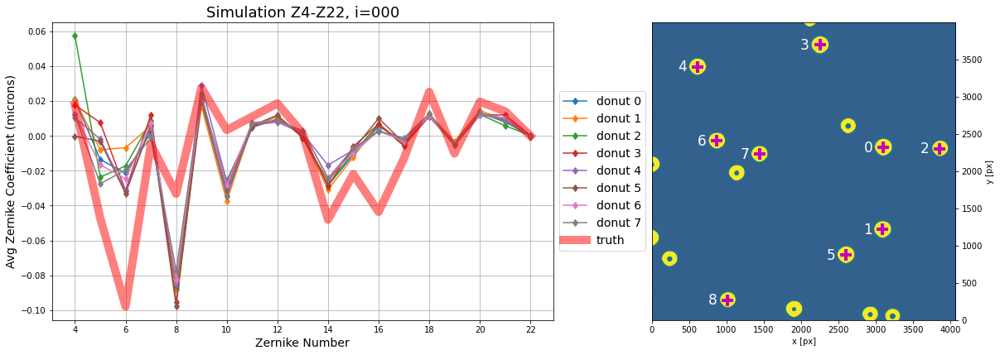

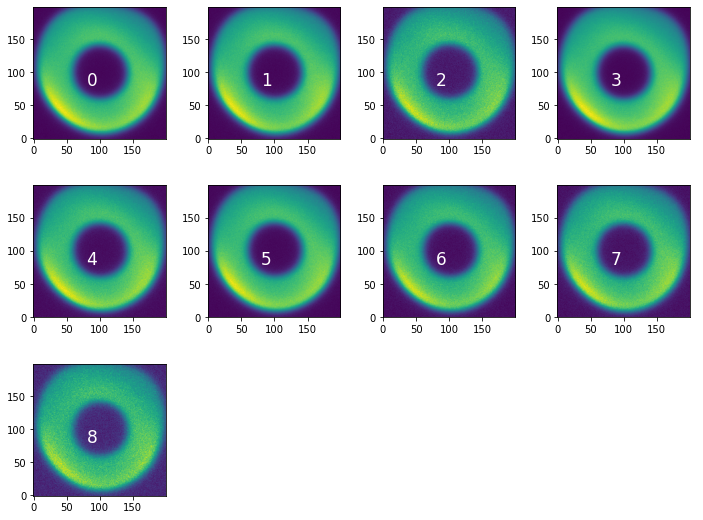

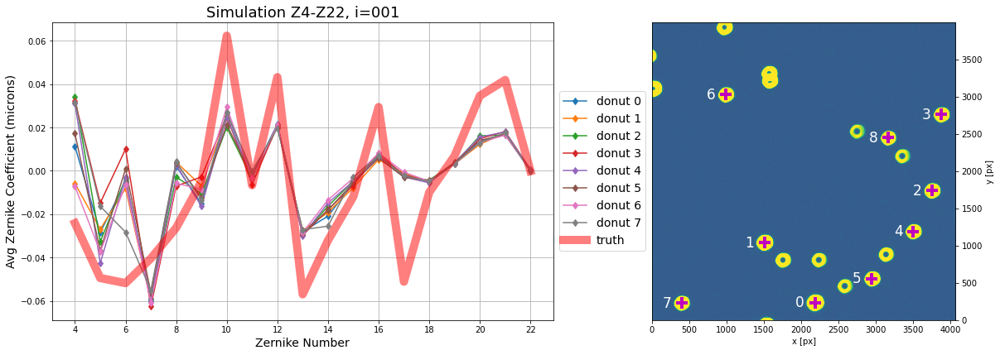

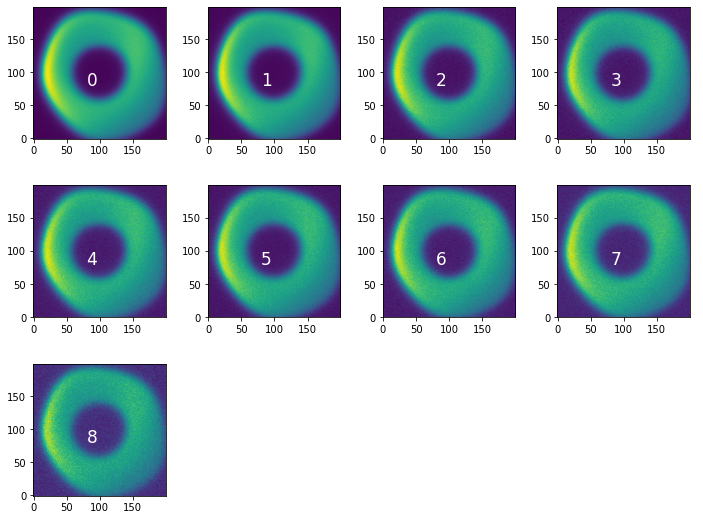

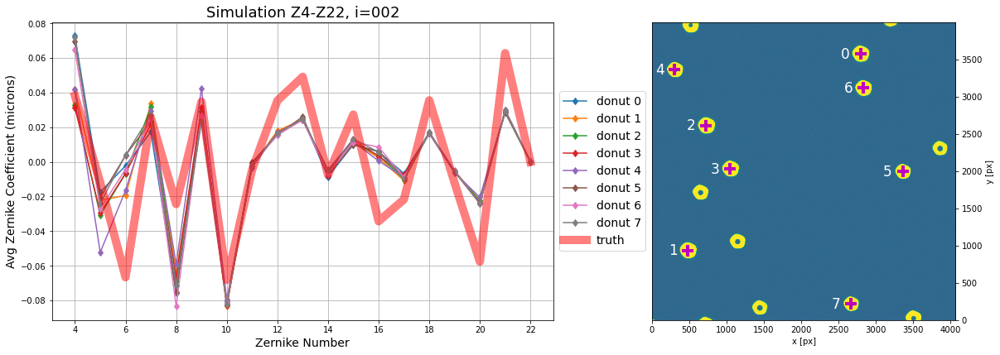

...

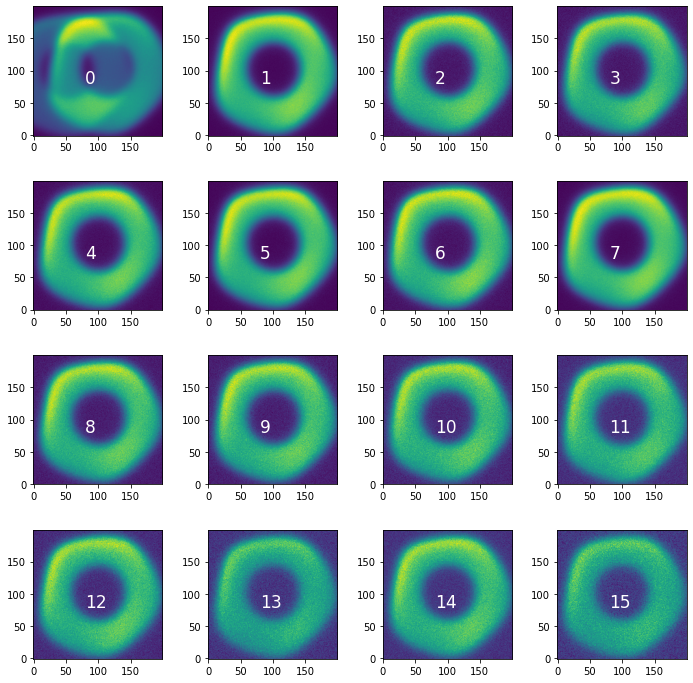

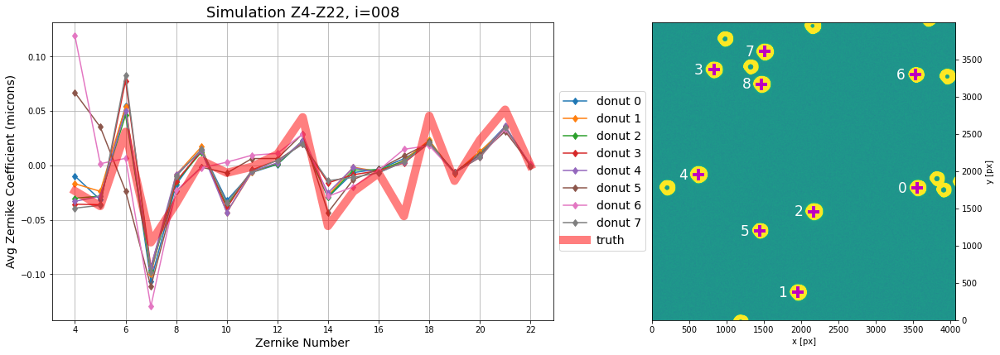

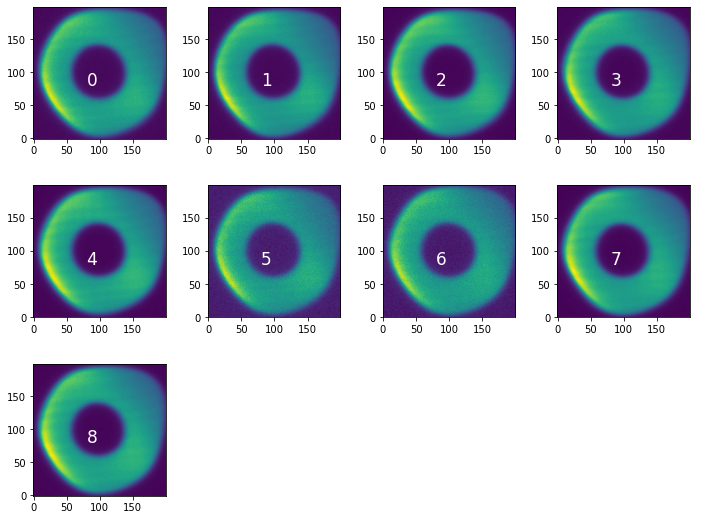

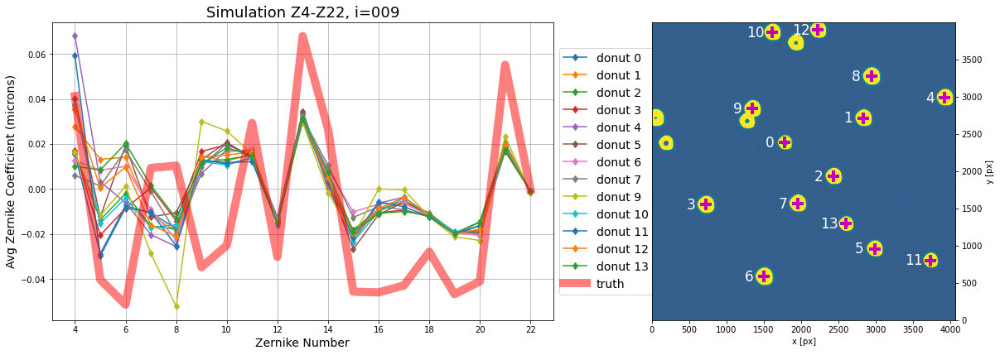

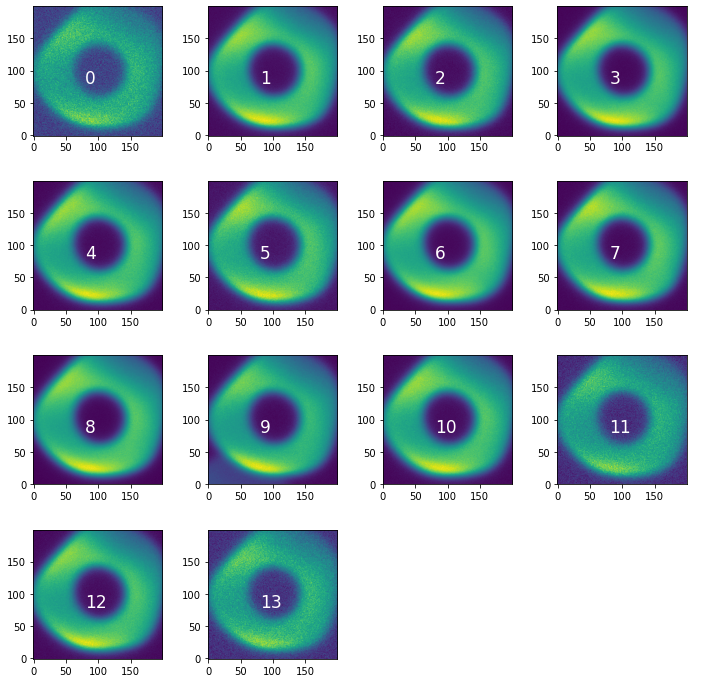

In [4]:
%matplotlib inline
for i in range(10):
    plot_simulation_results(source='Z4-Z22', iNum=i)

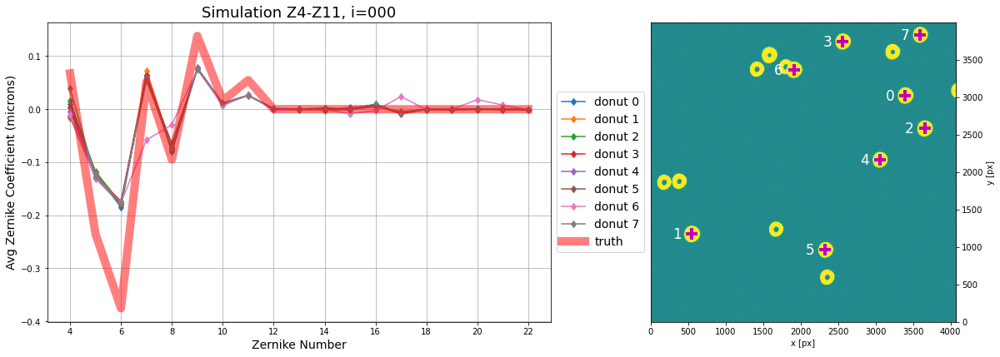

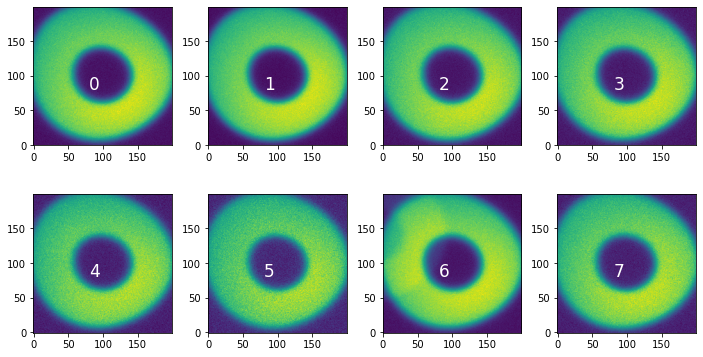

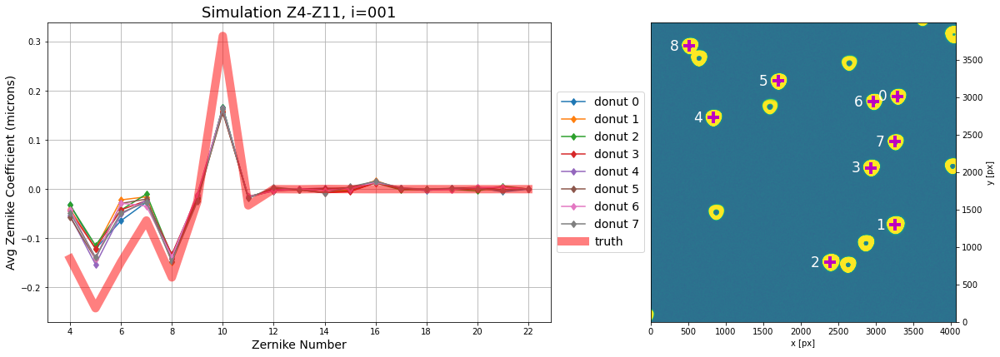

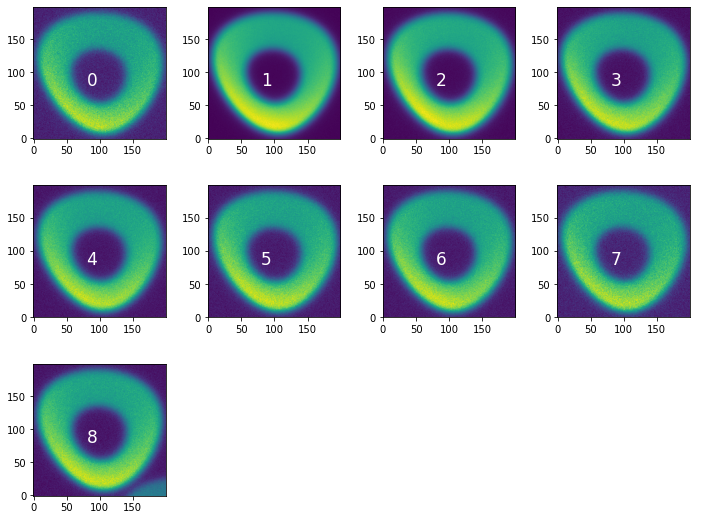

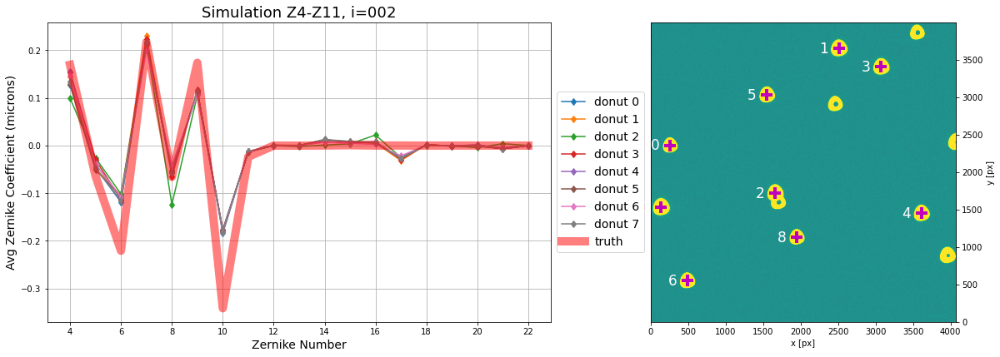

...

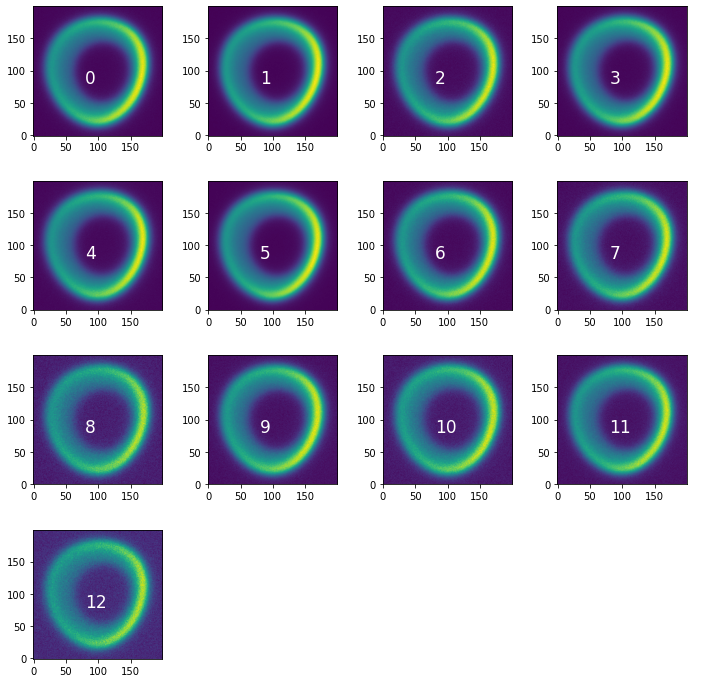

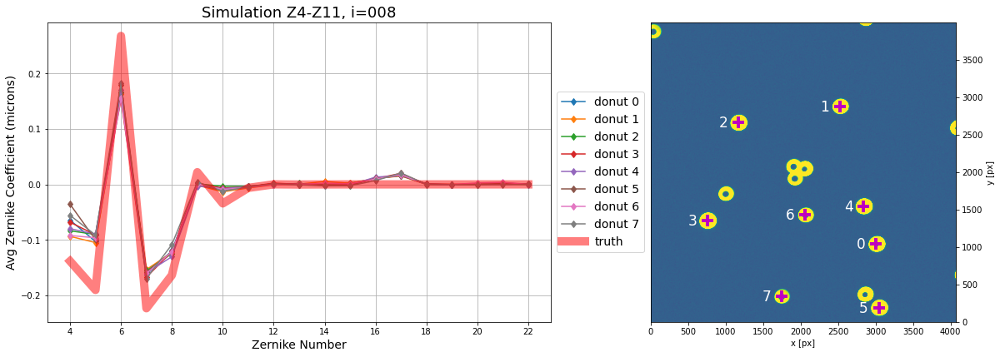

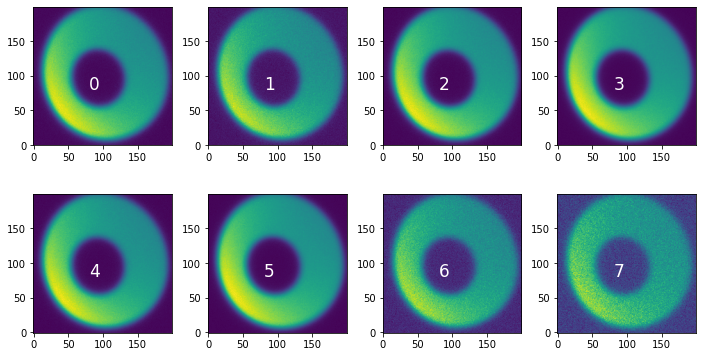

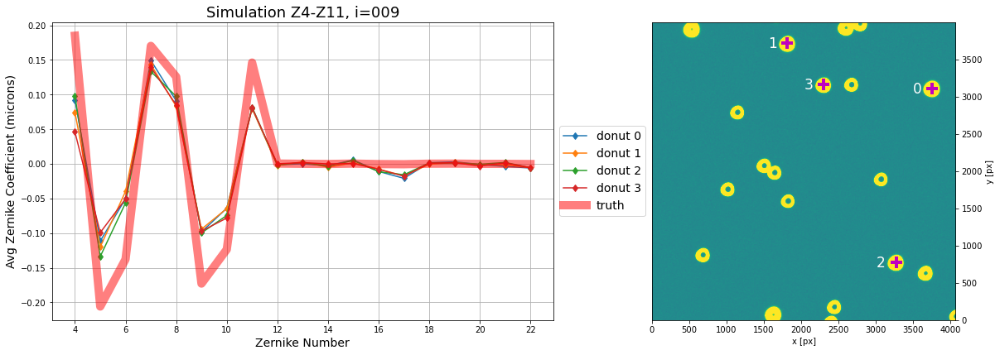

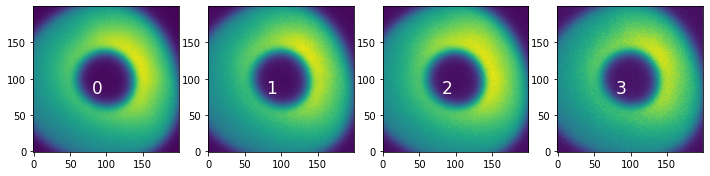

In [5]:
for i in range(10):
    plot_simulation_results(source='Z4-Z11', iNum=i)

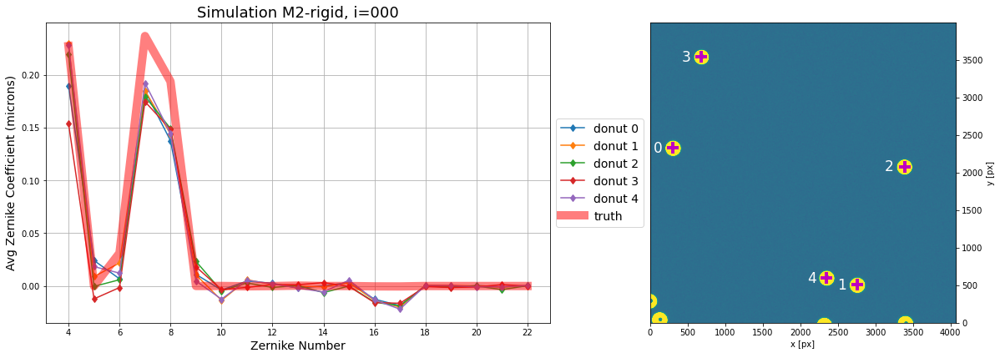

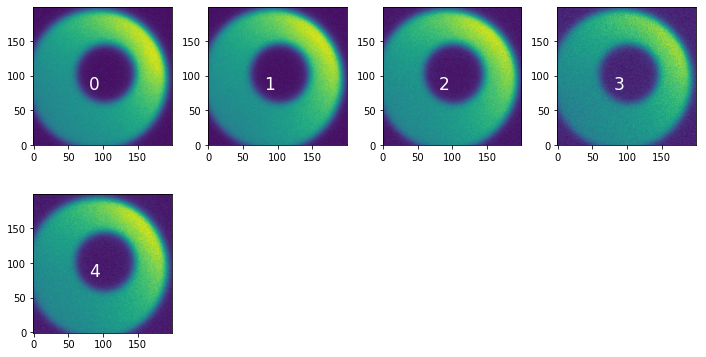

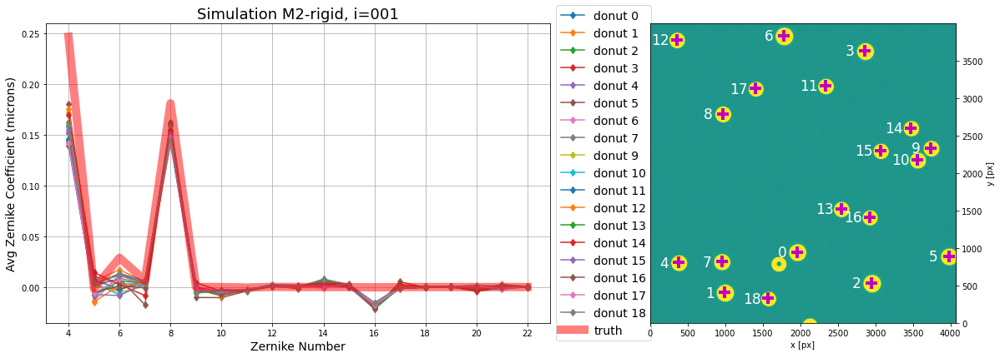

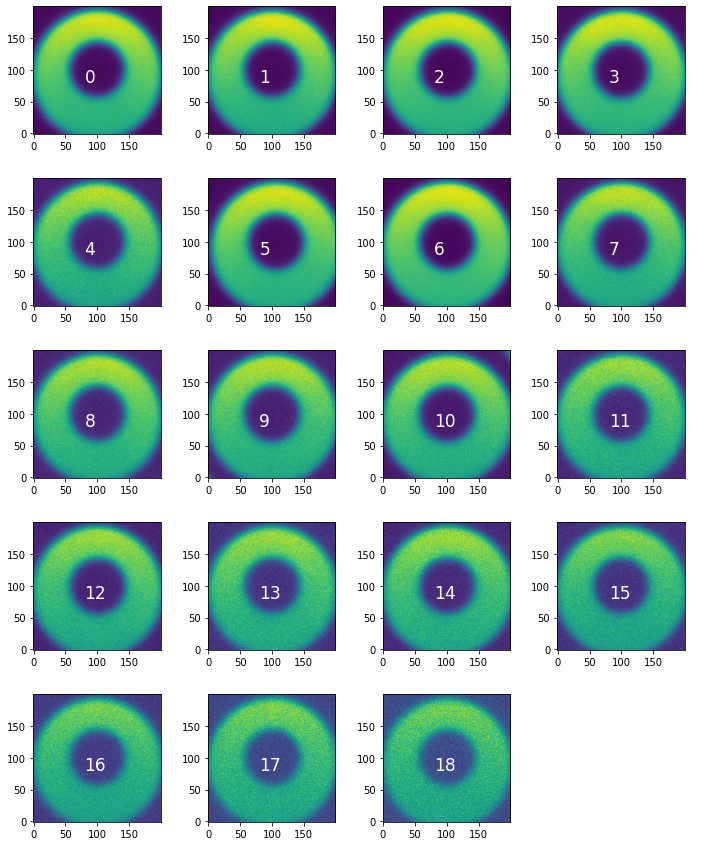

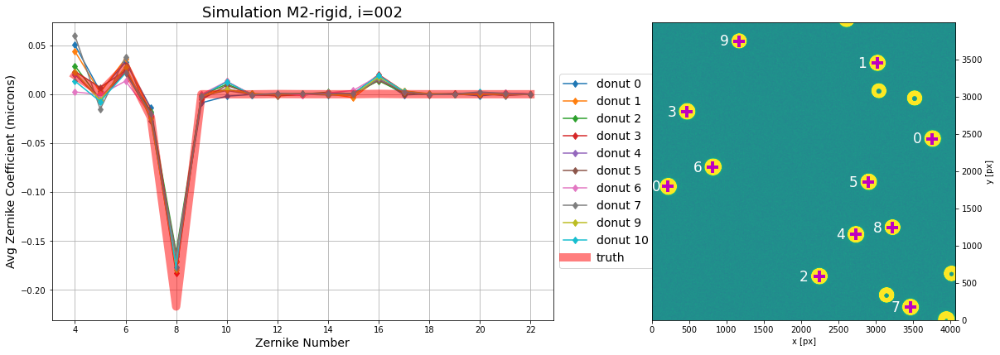

...

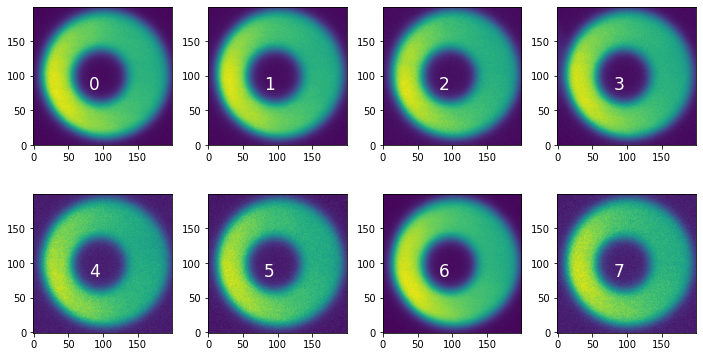

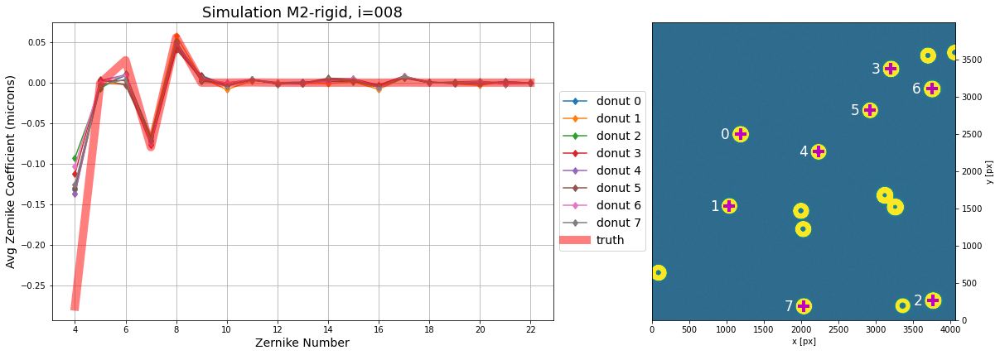

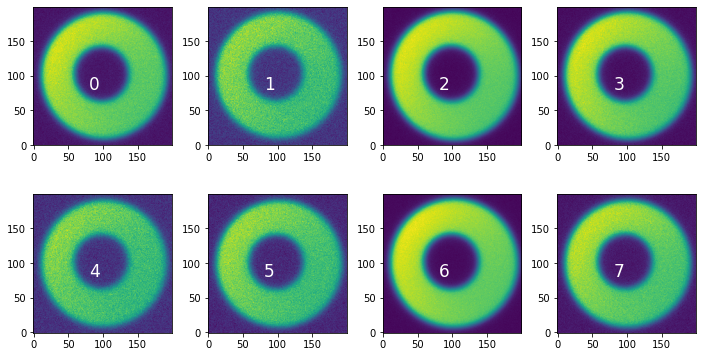

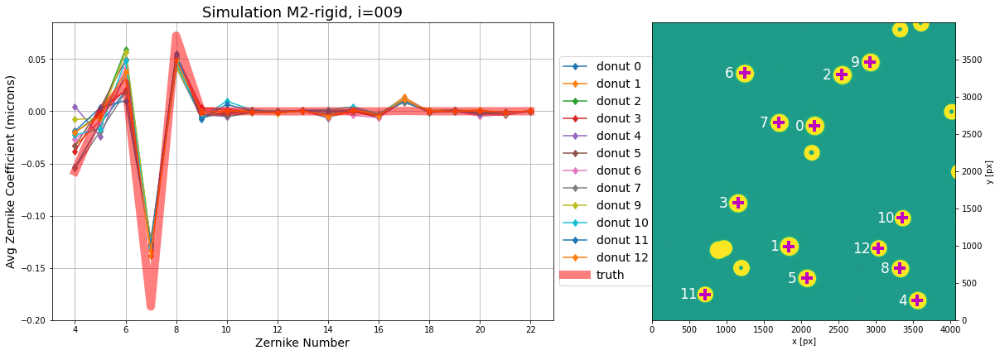

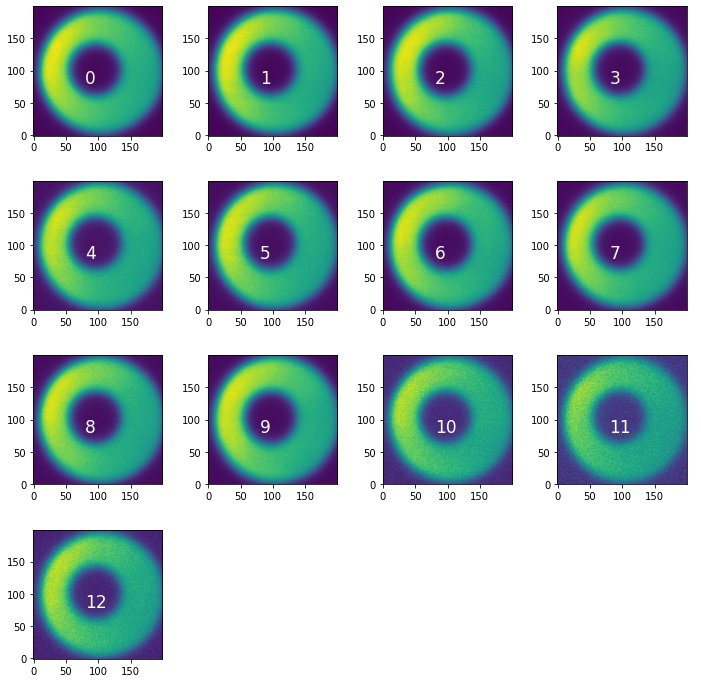

In [6]:
for i in range(10):
    plot_simulation_results(source='M2-rigid', iNum=i)

## Summarize 

Notice that in the above, the "bad" donuts are always unrecognized blends (since the algorithm should reject the blends). This is the case for:

   * `Z4-Z22`:
     * i=7, donut0, 
     * i=9, donut 9
   * `Z4-Z11`:
     * i=5, donuts 0,11,
     * i=6, donut 0
   * `M2-rigid`:
     * i=6, donut 6
     
Also, for two exposures the number of detected donuts is very low (`Z4-Z11`, `i=6`, and `i=9`). This could be because the threshold for adaptative fitting is too high. 

In [1]:
bad_donuts = {'Z4-Z22':{7:[0], 9:[9]},   # 'simulation setup':{iNum:[list of donuts to ignore]}
              'Z4-Z11':{5:[0,11], 6:[0]},
              'M2-rigid':{6:[6]}
             }

In [17]:
import numpy as np

results = {}
for source in ['Z4-Z22','Z4-Z11', 'M2-rigid']:
    results[source] = {}
    for iNum in range(10):
        results[source][iNum]={}

        # read the fit results 
        zkResultsFile = f'zerDic_{source}_{iNum}_N.npy'
        #if source == 'M2-rigid':
        #    zkResultsFile = f'zerDic{iNum}.npy'
        zkFit = np.load(zkResultsFile, allow_pickle=True).item()

        # choose just one since two are stored so that 
        # the number of input connections (two exposures)
        # matches the number of output connections
        # (two identical sets of zks and donut stamps)
        rawZks = zkFit['outputZernikesRaw'][0]

        if iNum in bad_donuts[source].keys():
            bad_donuts_ids = bad_donuts[source][iNum]
            print(f'For {source}, iNum={iNum}, bad donuts are {bad_donuts_ids}')

            # loop over raw zks and keep only the good ones
            keepZks =  []
            for i in range(len(rawZks)):
                if i in bad_donuts_ids: # don't append the bad ones 
                    continue
                keepZks.append(rawZks[i])

        else:
            keepZks = rawZks

        results[source][iNum]=keepZks

For Z4-Z22, iNum=7, bad donuts are [0]
For Z4-Z22, iNum=9, bad donuts are [9]
For Z4-Z11, iNum=5, bad donuts are [0, 11]
For Z4-Z11, iNum=6, bad donuts are [0]
For M2-rigid, iNum=6, bad donuts are [6]


Calculate the difference between truth and the median of all donuts:

In [23]:
len(np.median(results['Z4-Z22'][7],axis=0))

19

In [24]:
# store truth in a similar dic
truth = {}
for source in ['Z4-Z22','Z4-Z11', 'M2-rigid']:
    truth[source] = {}
    
    # need to introduce a multiplicative factor because
    # truth for Z4-Z22 and Z4-Z11 has opposite sign 
    # to the fit result convention 
    if source == 'Z4-Z22' or source == 'Z4-Z11':
        multiplyFactor = -1 
    elif source == 'M2-rigid':  
        multiplyFactor = 1 
        
    for iNum in range(10):
        # read the truth 
        fpath =f'/home/jemeyers/AuxTelSims/{source}/sim_00{iNum}.yaml'

        with open(fpath) as fh:
            true_result = yaml.safe_load(fh)

        zkSim = true_result['zern']
    
        truth[source][iNum] =  multiplyFactor*np.array(zkSim[4:]) # keep just zks 4:22 since those are fit 
             

In [25]:
stats = {}
for source in ['Z4-Z22','Z4-Z11', 'M2-rigid']:
    stats[source] = {}
    for iNum in range(10):
        stats[source][iNum] = {}
        
        # calculate median 
        median =  np.median(results[source][iNum],axis=0) 
        stats[source][iNum]['median'] = median # median across all donuts, len=19
        
        # calculate the residuals
        input_value= truth[source][iNum]
        residual = median - input_value
        stats[source][iNum]['residual'] = residual
        
        

In [42]:
for source in ['Z4-Z22', 'Z4-Z11', 'M2-rigid']:
    print(source, stats[source].keys())

Z4-Z22 dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Z4-Z11 dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
M2-rigid dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])


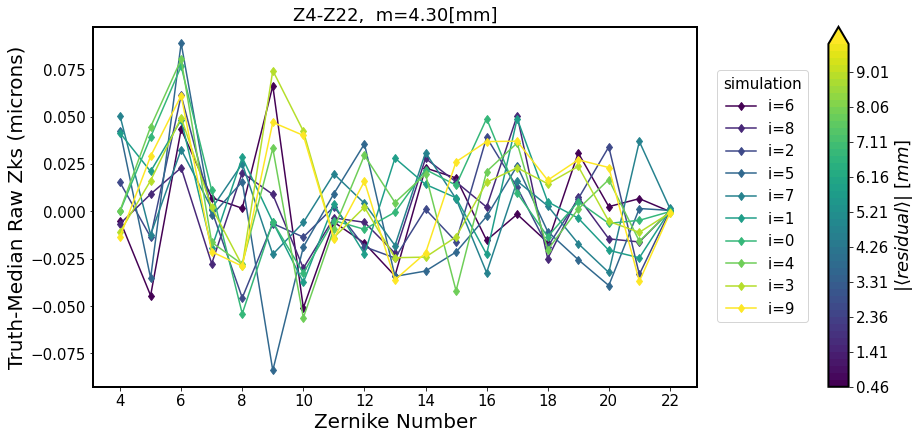

In [109]:
from astropy.table import Table
import matplotlib.lines as mlines
import matplotlib as mpl

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18

def plot_residuals(stats, source='Z4-Z22'):
    # plot the figure ...   
    fig = plt.figure(figsize=(14, 5))

    ax1 = fig.add_axes([0,0,0.6,1])  
    
    # calculate mean residual, sort by that 
    mean = []
    for iNum in range(10):
        mean_residual = np.abs(np.mean(stats[source][iNum]['residual']))
        mean.append(mean_residual)
    
    res = Table(data=[mean, np.arange(10)], names=['mean','iNum'])
    res.sort('mean')


    n_lines = 10
    color_idx = np.linspace(0, 1, n_lines)
    i=0
    #ax_legend_handles = []
    cmap = plt.cm.viridis
    for iNum in res['iNum']:
        color = cmap(color_idx[i])
        mean = res['mean'][i]
        ax1.plot(np.arange(4, 23), stats[source][iNum]['residual'], '-d', 
                 c=color,
                 label=f'i={iNum} ')
    
        line = mlines.Line2D([], [], color=color, ls='-', marker='o', alpha=1,
                                 )
        #ax_legend_handles.append(f'{mean_residual.round(4)} ')
    
        i+=1
    ax1.set_xlabel('Zernike Number', )#size=18)
    ax1.set_ylabel('Truth-Median Raw Zks (microns)',)# size=14)
        
    ax1.set_xticks(np.arange(4,23)[::2])
    ax1.legend(title='simulation', bbox_to_anchor=[1.02, 0.9],ncol=1)
    ax1.set_title(f"{source},  m={1000*np.mean(res['mean']):.2f}[mm]", fontsize=18)
    
    # convert microns to mm 
    bounds = 1000*np.linspace(min(res['mean']), max(res['mean'])) 
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='max')

    #add_axes([xmin,ymin,dx,dy]) 
    cax = fig.add_axes([0.73,0,0.02,1])
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
                 cax=cax, orientation='vertical',
                       format='%.2f'
                      # label=  r"$|\langle residual \rangle | [\mu m]$",
                       )

    cbar.ax.tick_params(labelsize=15,)# orientation='vertical')
    cbar.set_label(label=  r"$|\langle residual \rangle | \,\, [mm]$", size=18)
    #cbar.ax.set_yticklabels(["{:.1%}".format(i) for i in cbar.get_ticks()])
plot_residuals(stats)

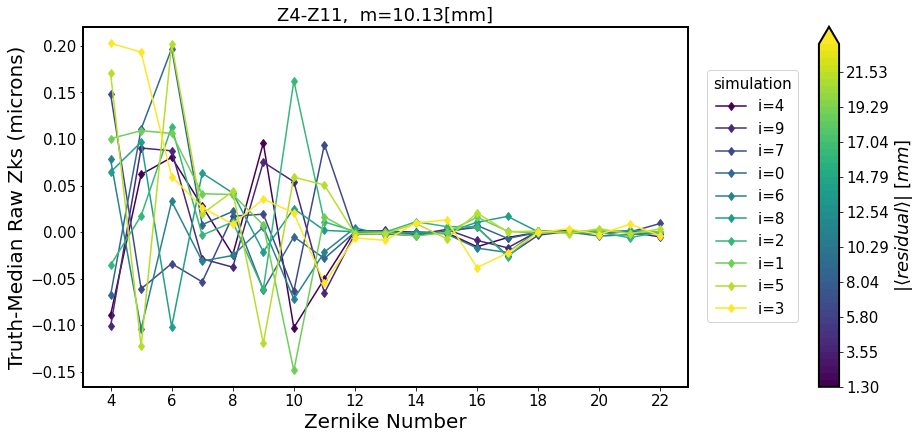

In [110]:
plot_residuals(stats, source='Z4-Z11')

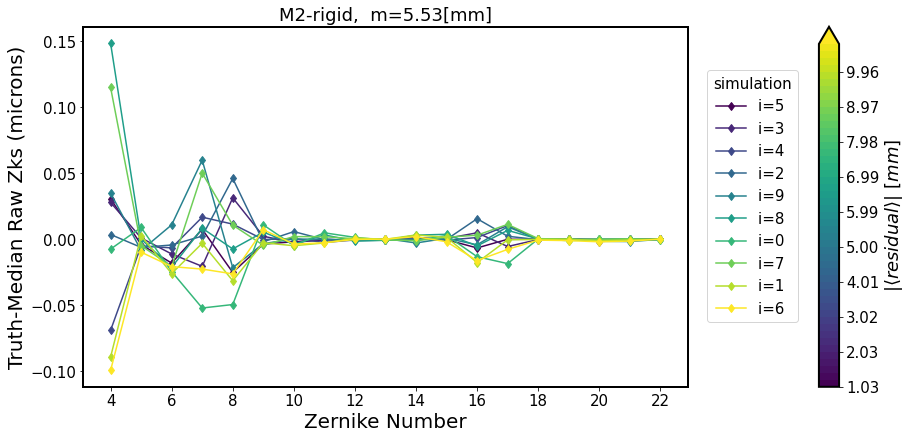

In [111]:
plot_residuals(stats, source='M2-rigid')


For each simulation we calculated the median fitted Zernike coefficients across all donuts, `avgZk`. Given the `trueZk`, we calculate the residual for each simulation as `res = trueZk-avgZk` (plotted above and colored by absolute value of `res`) . We also calculate the mean of `res` across all simulations for a given setup. This is the number `m` in the title of each figure above. 


This shows that residuals overall are between on average 4 and 10 mm, smaller for `M2-rigid` where lower order Zks were excited, and larger for `Z4-Z22` where higher orders were excited. 

## [Aside]: Calculate the variance for each donut as a departure from the median

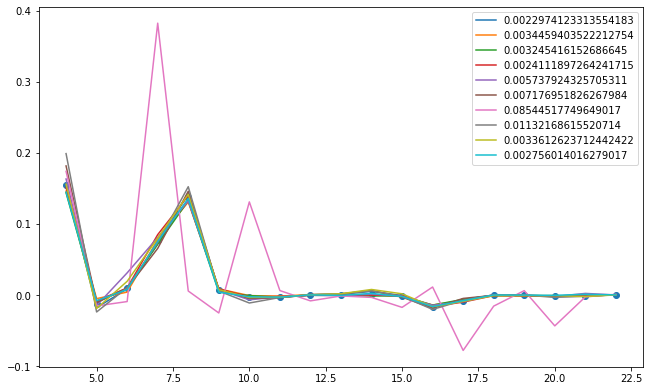

In [26]:
source = 'M2-rigid'
iNum='6'
# read the fit results 
zkResultsFile = f'zerDic_{source}_{iNum}_N.npy'
#if source == 'M2-rigid':
#    zkResultsFile = f'zerDic{iNum}.npy'
zkFit = np.load(zkResultsFile, allow_pickle=True).item()

# choose just one since two are stored so that 
# the number of input connections (two exposures)
# matches the number of output connections
# (two identical sets of zks and donut stamps)
rawZks = zkFit['outputZernikesRaw'][0]

# plot the figure ...   
fig = plt.figure(figsize=(14, 5))

####################################
### left - plot the fit results  ###
#################################### 

#add_axes([xmin,ymin,dx,dy]) 
ax1 = fig.add_axes([0,0,0.6,1])  

medianZks = np.median(rawZks, axis=0)
ax1.scatter(np.arange(4, 23), medianZks)
var = []
for i in range(len(rawZks)):#[0,1,2,3,4,5,6,7]:
    
    variance=np.sqrt(np.mean(np.square(rawZks[i]-medianZks)))
    var.append(variance)
    ax1.plot(np.arange(4, 23),rawZks[i], label=f'var={str(variance)[:6]}')
ax1.set_xticks(np.arange(4,23)[::2])
ax1.legend()

This method would be too hard to fine-tune, so create a dict of a few "bad" donuts to ignore in summarizing the plots